<a name="top"></a>

In [1]:
import sys, os
import matplotlib.pyplot as plt
sys.path.append('../')
from sklearn.metrics import mean_squared_error
import re
import numpy as np

In [2]:
import random

In [3]:
from tqdm.notebook import tqdm

In [4]:
from core.models import rUNet
from core.utils.inference import inference_phase_rUNet_plot_notebook
from core.utils.data import define_dataset, select_dist

In [5]:
from functools import partial

In [6]:
import torch

In [7]:
%matplotlib inline

In [8]:
regex = re.compile(r'\d+')

In [9]:
saved_models = '/storage/yw18581/src/leaf_reco/saved_models/trained_6positions_multi_loss/'

In [10]:
root_path = partial(os.path.join, saved_models)

In [11]:
data_folder = ('/storage/yw18581/data/dataset/')

In [12]:
model_names = os.listdir(saved_models)

In [13]:
def get_fnames(coeff, prefix='Trained'):
    idx_coef = 6 if prefix=='Trained' else 4
    idx_epoch = 5 if prefix =='Trained' else 3
    f_list = []
    epochs = []
    for fname in model_names:
        if fname.startswith(prefix):
            if regex.findall(fname.split("_")[idx_coef])[1]==str(coeff):
                epoch = int(regex.findall(fname.split("_")[idx_epoch])[0]) 
                epochs.append(epoch)
                if int(regex.findall(fname.split("_")[idx_epoch])[0])==epoch:
                    f_list.append(fname)
    
    return np.array(f_list)[np.argsort(epochs)], np.sort(epochs)

In [14]:
training_dist = [2,4,10,20,25,35]
unseen_dist = [1,3,15,30]

In [15]:
selected_distances = select_dist(root_folder=data_folder, dist_list=unseen_dist)

In [16]:
def plot_transformed_data(data_loaders, data_length):
    
    for i, batch in enumerate(data_loaders):
        
        true_images, true_masks, true_dists = batch["image"], batch["mask"], batch["dist"]
        print("batch {}".format(i + 1))
        
        for j, (img, tr_msk, tr_dist) in enumerate(zip(true_images,true_masks,
                                                    true_dists.cpu().detach().numpy())):
            print("{}: true_dist: {}".format(j + 1, tr_dist))

            f = plt.figure(figsize=(10, 5))
            f.add_subplot(1, 2, 1)
            plt.imshow(img[0, ...], cmap='gray')
            f.add_subplot(1, 2, 2)
            plt.imshow(tr_msk[0, ...], cmap='gray')
            plt.show()
        
        print('end batch {}'.format(i+1))
        
        if i == 3:
            break

In [17]:
from core.utils.data.dataset import UNetDatasetFromFolders, UNetDataSetFromNpz, UNetDatasetImagesOnly
from core.utils.data.transformers import ChannelsFirst, Rescale, ToTensor, Crop, GaussianNoise, RandomCrop, Swap, FlipUD, FlipLR

In [18]:
from torch.utils.data import DataLoader

In [19]:
from torchvision.transforms import Compose

## Transformer Tests

- [`RandomCrop`](#randomcrop)
- [`Swap`](#swap)
- [`FlipUD`](#flipud)
- [`FlipLR`](#fliplr)
- [`Rescale`](#rescale)
- [`GaussianNoise`](#noise)


---

<a name="randomcrop"></a>

## `RandomCrop` Test

#### Testing single CROP operations (varying rows offset) on single images

In [21]:
dataset = UNetDatasetFromFolders(data_folder, fname_key='File', file_extension='.tiff',
                                 included=selected_distances)

In [22]:
from core.utils.data.transformers import COL_SLICE

In [23]:
offset = RandomCrop.ROWS_OFFSET

In [24]:
choices = RandomCrop.CROP_CHOICES

In [25]:
choices

[0, 200, 500, 750, 1000]

ROW SLICE:  slice(0, 1400, None)


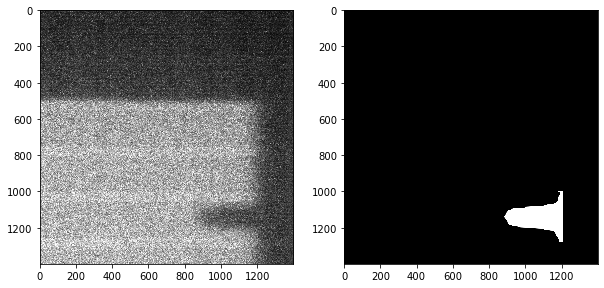

ROW SLICE:  slice(200, 1600, None)


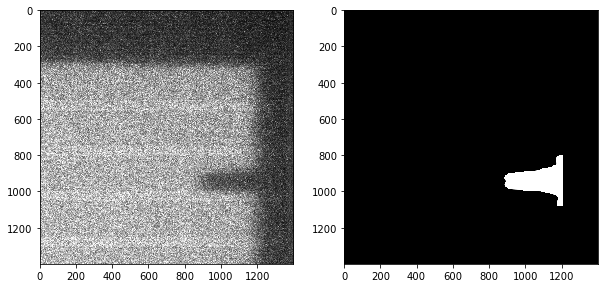

ROW SLICE:  slice(500, 1900, None)


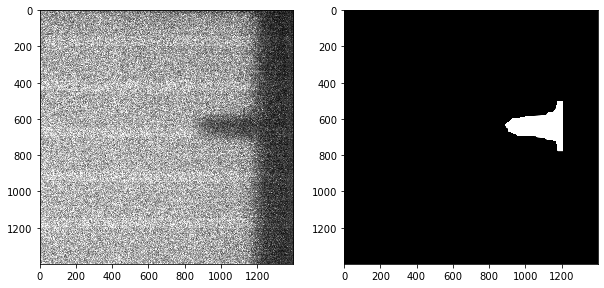

ROW SLICE:  slice(750, 2150, None)


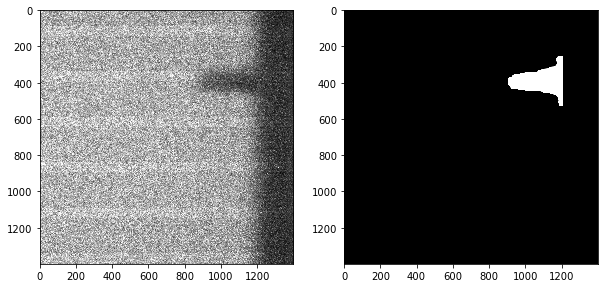

ROW SLICE:  slice(1000, 2400, None)


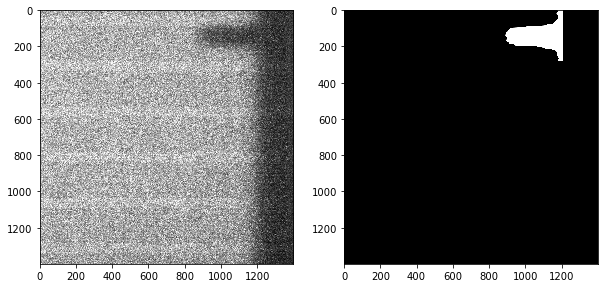

In [26]:
for i, c in enumerate(choices):
    row_slice = slice(c, c+offset)
    img, mask = dataset[i]['image'], dataset[i]['mask']
    img = img[row_slice, COL_SLICE]
    mask = mask[row_slice, COL_SLICE]
    print('ROW SLICE: ', row_slice)
    f = plt.figure(figsize=(10, 5))
    f.add_subplot(1, 2, 1)
    plt.imshow(img, cmap='gray')
    f.add_subplot(1, 2, 2)
    plt.imshow(mask, cmap='gray')
    plt.show()

[TOP](#top)

---

#### Testing `RandomCrop`  using `DataLoader`

In [27]:
dataset = UNetDatasetFromFolders(data_folder, fname_key='File', file_extension='.tiff',
                                 included=selected_distances,
                                 transform=Compose([RandomCrop(), ChannelsFirst(), ToTensor()]))

data_loader = DataLoader(dataset, batch_size=4, num_workers=4)

batch 1
1: true_dist: 15


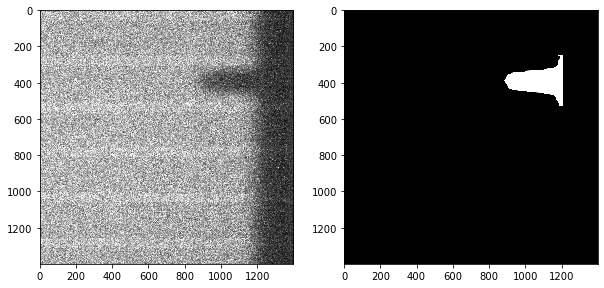

2: true_dist: 15


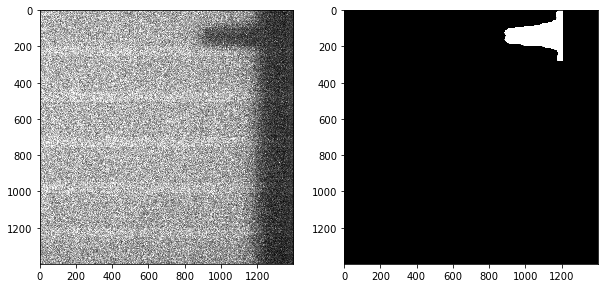

3: true_dist: 15


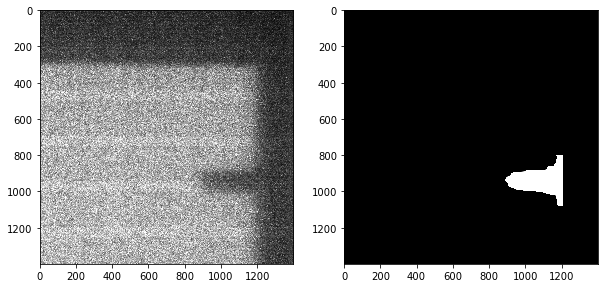

4: true_dist: 15


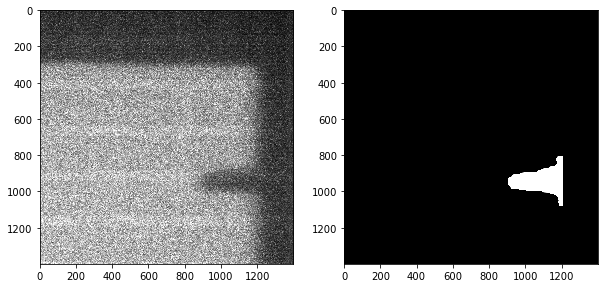

end batch 1
batch 2
1: true_dist: 15


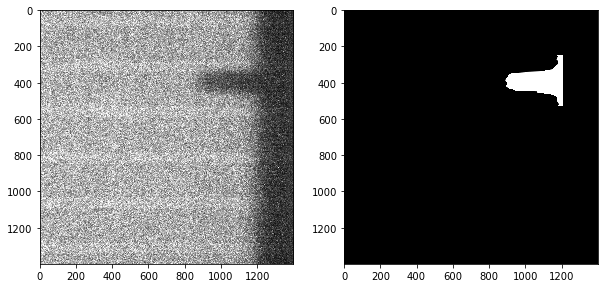

2: true_dist: 15


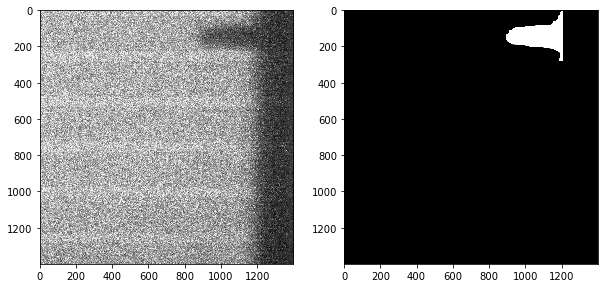

3: true_dist: 15


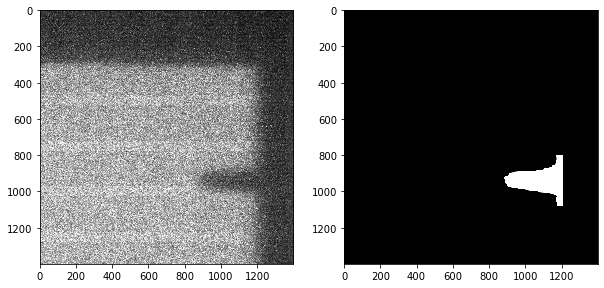

4: true_dist: 15


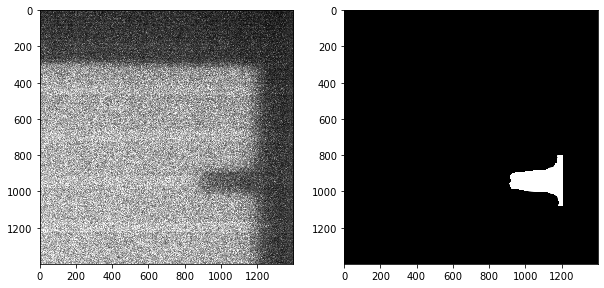

end batch 2
batch 3
1: true_dist: 15


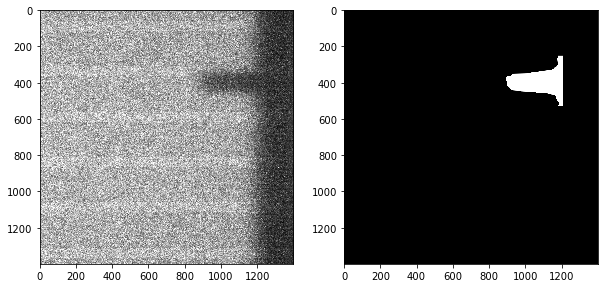

2: true_dist: 15


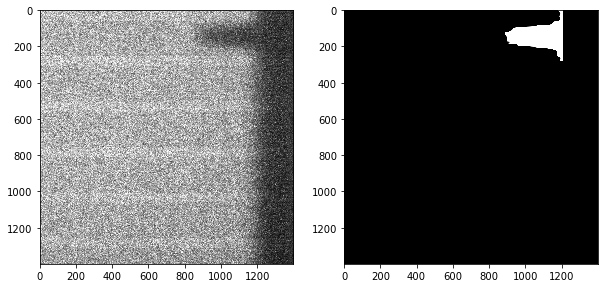

3: true_dist: 15


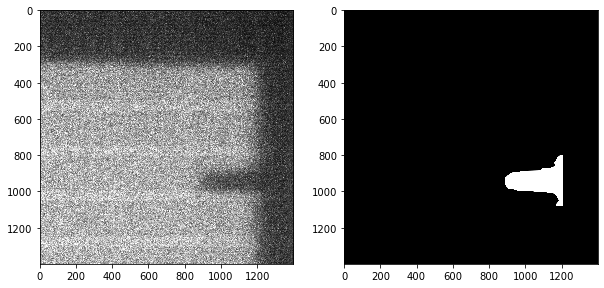

4: true_dist: 15


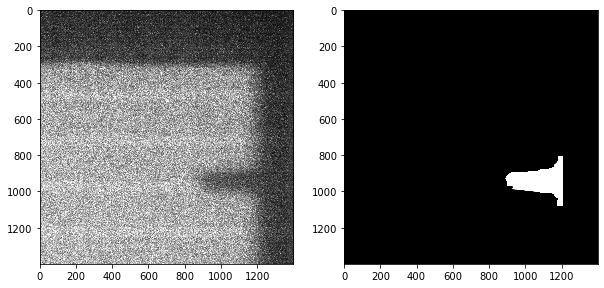

end batch 3
batch 4
1: true_dist: 15


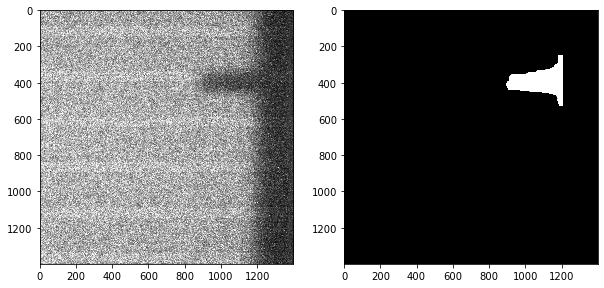

2: true_dist: 15


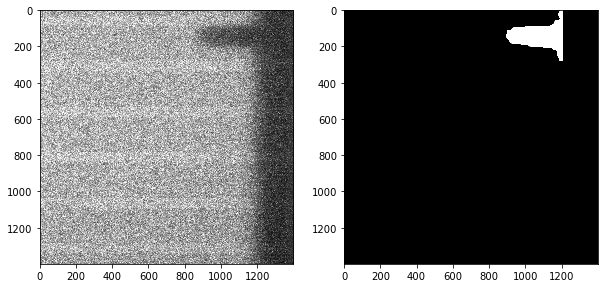

3: true_dist: 15


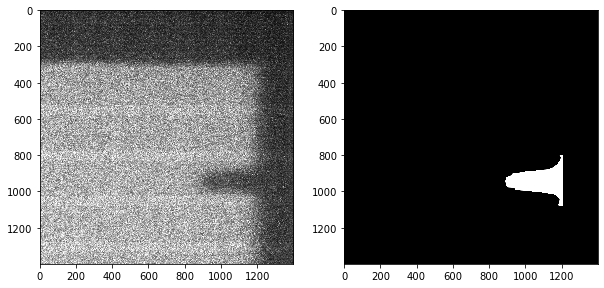

4: true_dist: 15


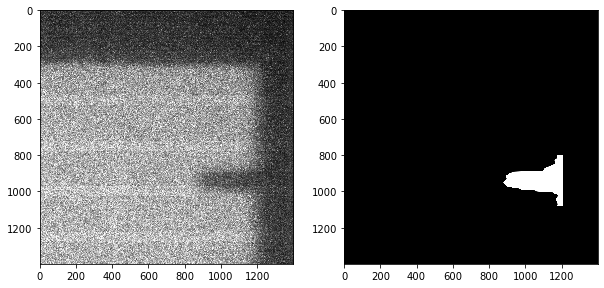

end batch 4


In [28]:
plot_transformed_data(data_loader, len(dataset))

[TOP](#top)

---

<a name="swap"></a>

## `Swap`

batch 1
1: true_dist: 15


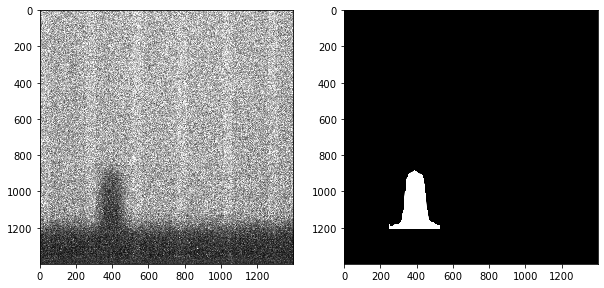

2: true_dist: 15


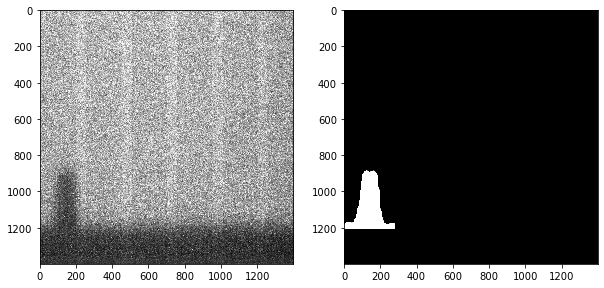

3: true_dist: 15


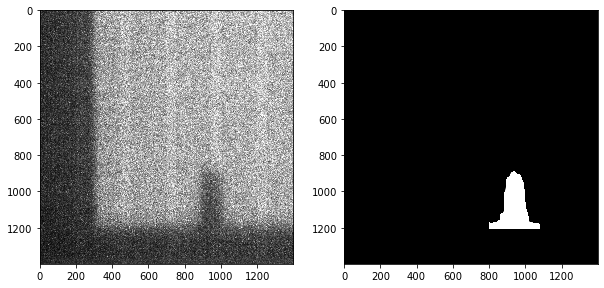

4: true_dist: 15


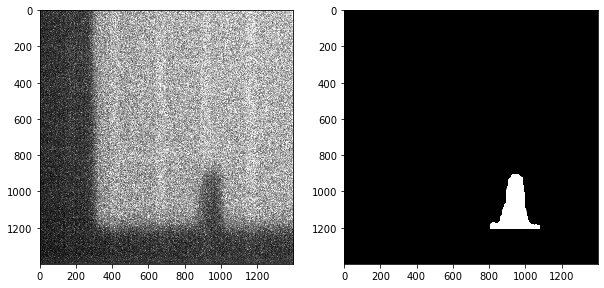

end batch 1
batch 2
1: true_dist: 15


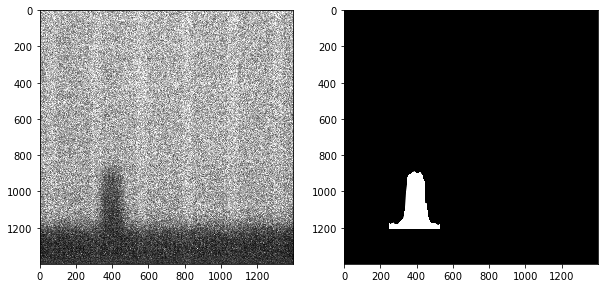

2: true_dist: 15


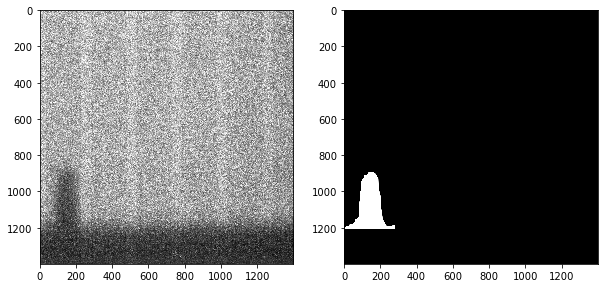

3: true_dist: 15


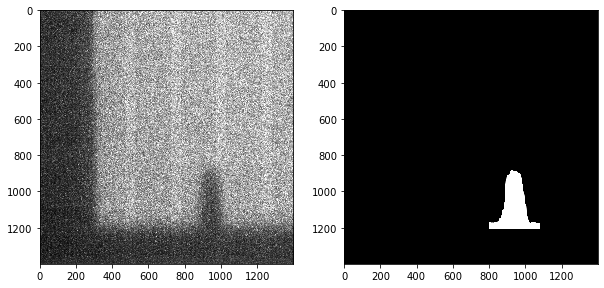

4: true_dist: 15


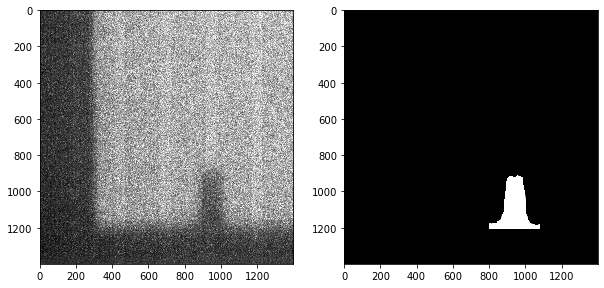

end batch 2
batch 3
1: true_dist: 15


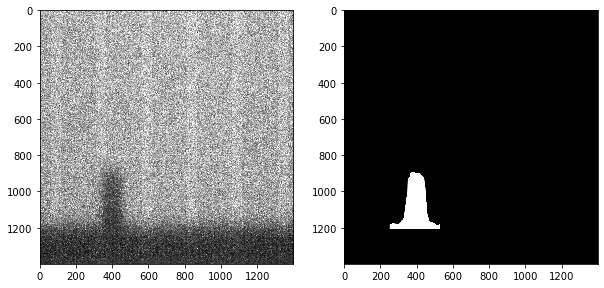

2: true_dist: 15


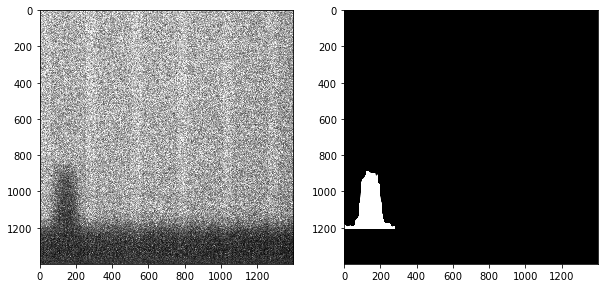

3: true_dist: 15


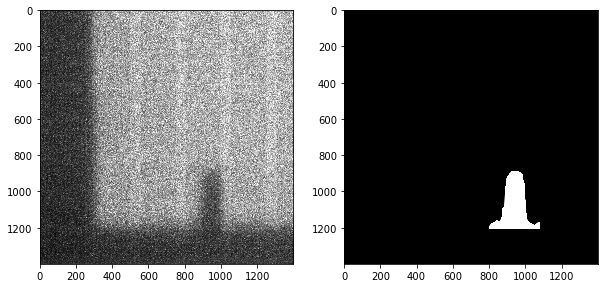

4: true_dist: 15


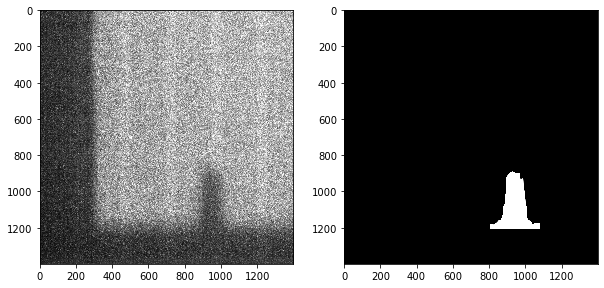

end batch 3
batch 4
1: true_dist: 15


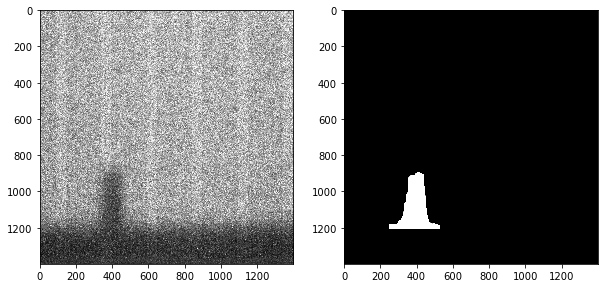

2: true_dist: 15


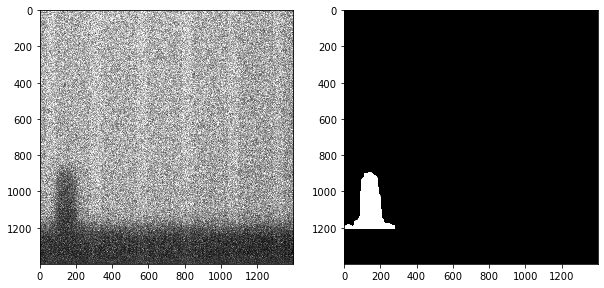

3: true_dist: 15


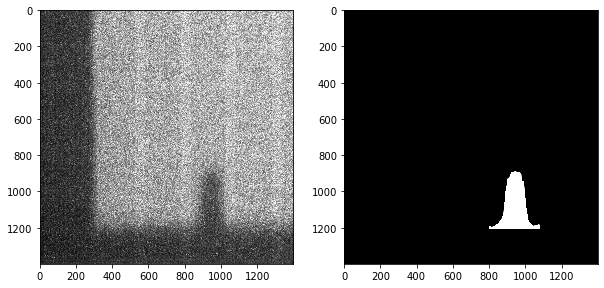

4: true_dist: 15


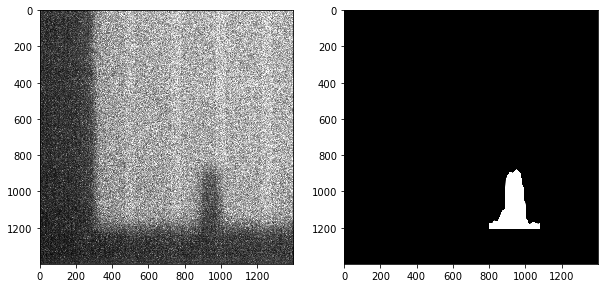

end batch 4


In [29]:
dataset = UNetDatasetFromFolders(data_folder, fname_key='File', file_extension='.tiff',
                                 included=selected_distances,
                                 transform=Compose([RandomCrop(), Swap(p=1.0), ChannelsFirst(), ToTensor()]))

data_loader = DataLoader(dataset, batch_size=4, num_workers=4)

plot_transformed_data(data_loader, len(dataset))

[TOP](#top)

---

<a name="flipud"></a>

## Testing `FlipUD`

##### Testing single operation

In [30]:
dataset = UNetDatasetFromFolders(data_folder, fname_key='File', file_extension='.tiff',
                     
                                 included=selected_distances)

In [31]:
tensor = dataset[0]['image']
tensor = tensor[0:1400, 1000:]

In [32]:
tensor = np.flipud(tensor) - np.zeros_like(tensor)

In [33]:
tensor = tensor[np.newaxis, ...]

In [34]:
ttensor = torch.from_numpy(tensor)

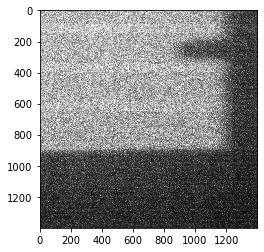

In [35]:
plt.imshow(ttensor.numpy()[0, ...], cmap='gray')
plt.show()

img shape:  (1400, 1400)
mask shape:  (1400, 1400)
img shape:  (1400, 1400)
mask shape:  (1400, 1400)


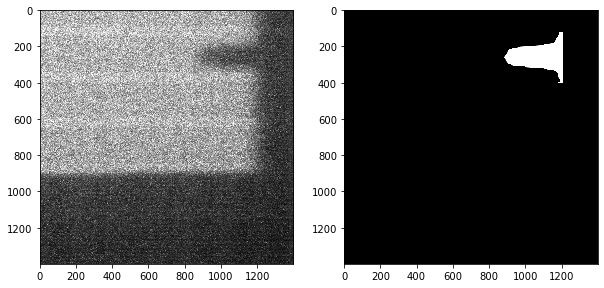

img shape:  (1400, 1400)
mask shape:  (1400, 1400)
img shape:  (1400, 1400)
mask shape:  (1400, 1400)


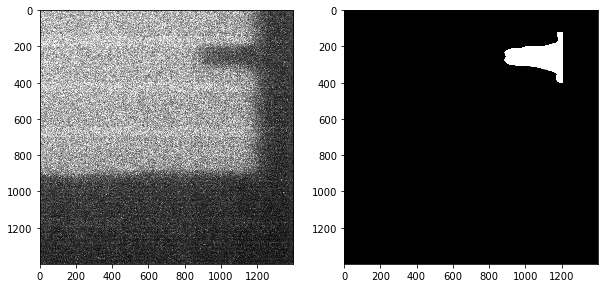

img shape:  (1400, 1400)
mask shape:  (1400, 1400)
img shape:  (1400, 1400)
mask shape:  (1400, 1400)


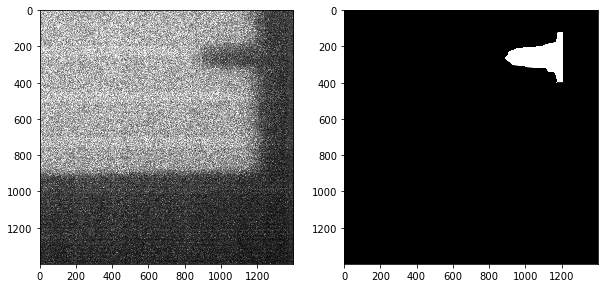

img shape:  (1400, 1400)
mask shape:  (1400, 1400)
img shape:  (1400, 1400)
mask shape:  (1400, 1400)


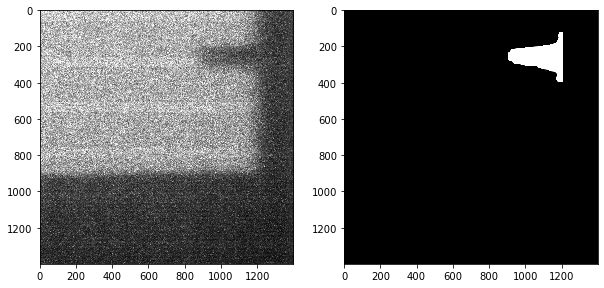

img shape:  (1400, 1400)
mask shape:  (1400, 1400)
img shape:  (1400, 1400)
mask shape:  (1400, 1400)


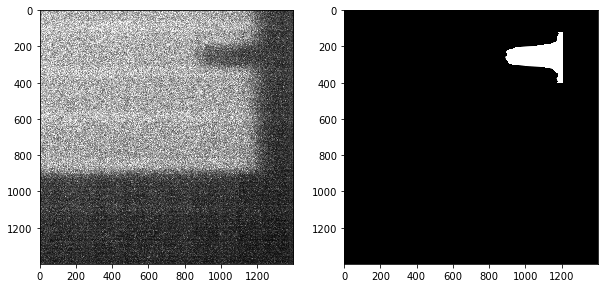

img shape:  (1400, 1400)
mask shape:  (1400, 1400)
img shape:  (1400, 1400)
mask shape:  (1400, 1400)


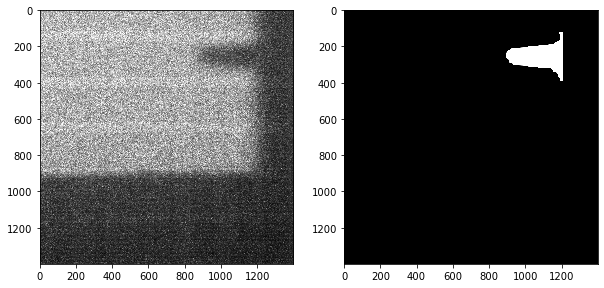

img shape:  (1400, 1400)
mask shape:  (1400, 1400)
img shape:  (1400, 1400)
mask shape:  (1400, 1400)


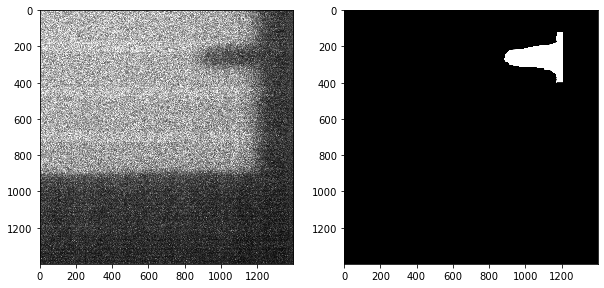

img shape:  (1400, 1400)
mask shape:  (1400, 1400)
img shape:  (1400, 1400)
mask shape:  (1400, 1400)


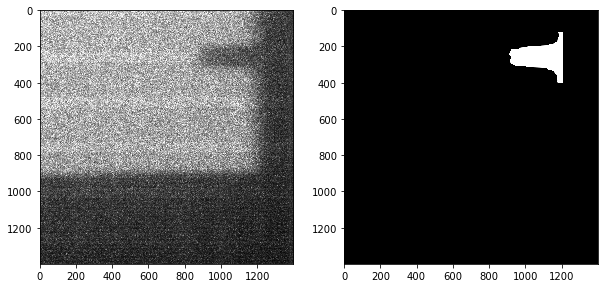

img shape:  (1400, 1400)
mask shape:  (1400, 1400)
img shape:  (1400, 1400)
mask shape:  (1400, 1400)


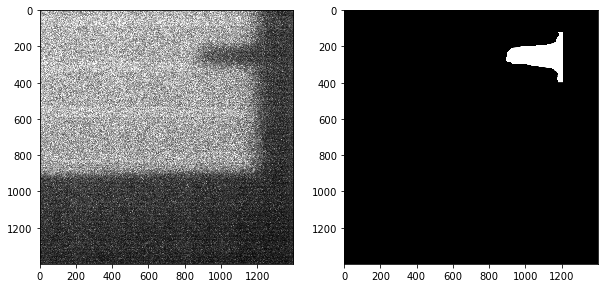

img shape:  (1400, 1400)
mask shape:  (1400, 1400)
img shape:  (1400, 1400)
mask shape:  (1400, 1400)


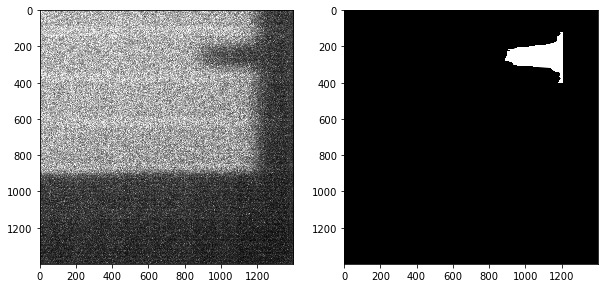

In [36]:
for i in range(10):
    img, mask = dataset[i]['image'], dataset[i]['mask']
    
    img = img[0:1400, 1000:]
    mask = mask[0:1400, 1000:]
    
    print('img shape: ', img.shape)
    print('mask shape: ', mask.shape)
    
    img = np.flipud(img)
    mask = np.flipud(mask)
    
    print('img shape: ', img.shape)
    print('mask shape: ', mask.shape)
    
    f = plt.figure(figsize=(10, 5))
    f.add_subplot(1, 2, 1)
    plt.imshow(img, cmap='gray')
    f.add_subplot(1, 2, 2)
    plt.imshow(mask, cmap='gray')
    plt.show()

[TOP](#top)

---

#### Testing `FlipUD` in `DataLoader`

batch 1
1: true_dist: 15


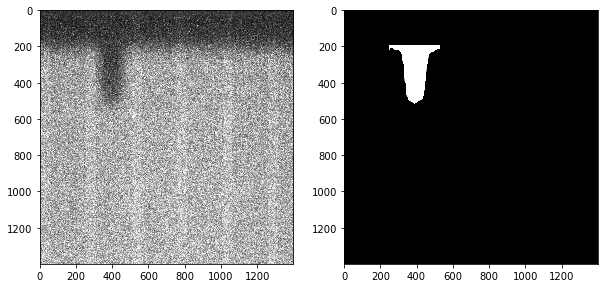

2: true_dist: 15


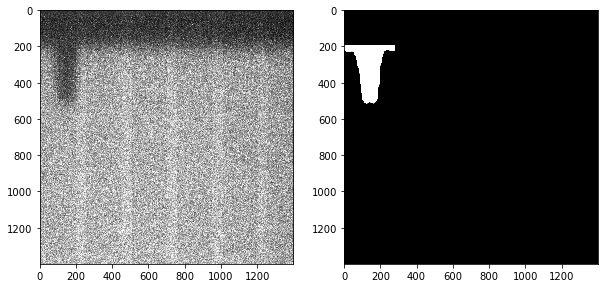

3: true_dist: 15


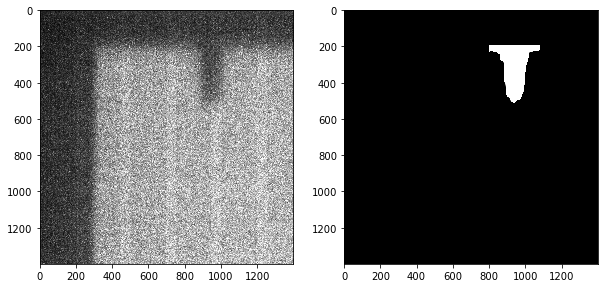

4: true_dist: 15


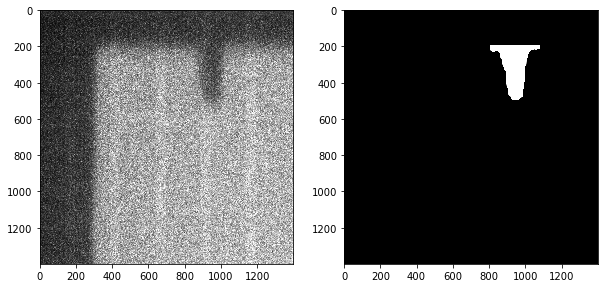

end batch 1
batch 2
1: true_dist: 15


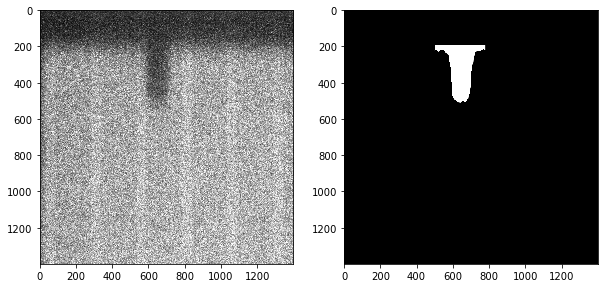

2: true_dist: 15


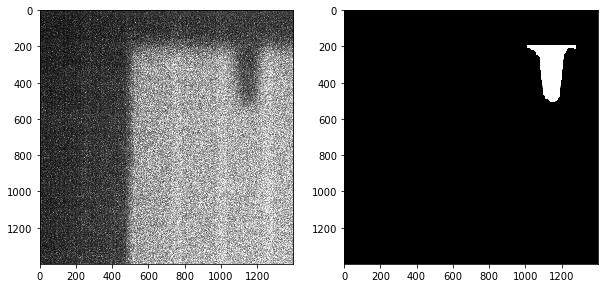

3: true_dist: 15


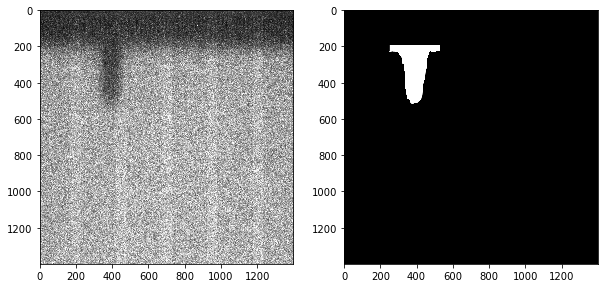

4: true_dist: 15


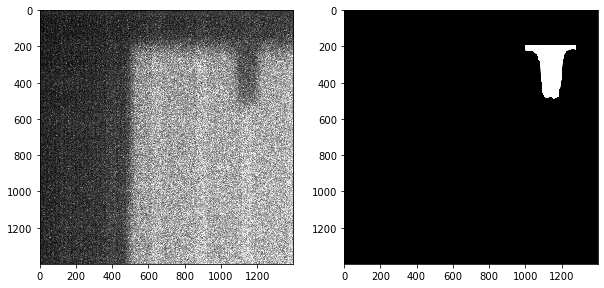

end batch 2
batch 3
1: true_dist: 15


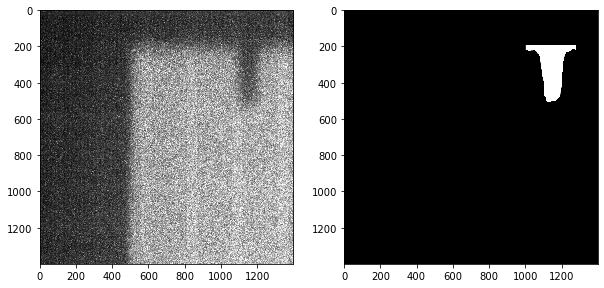

2: true_dist: 15


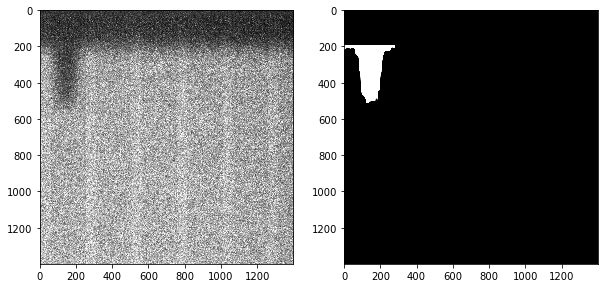

3: true_dist: 15


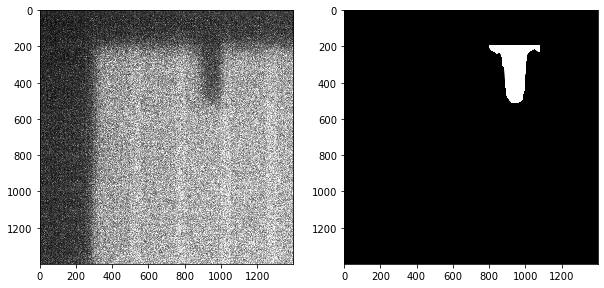

4: true_dist: 15


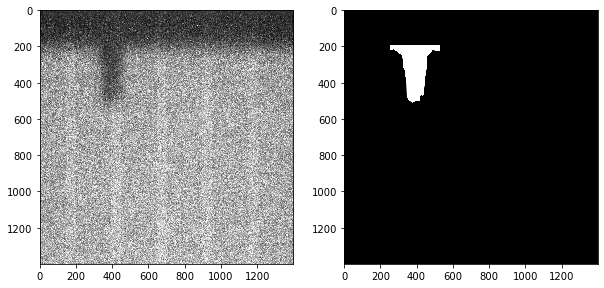

end batch 3
batch 4
1: true_dist: 15


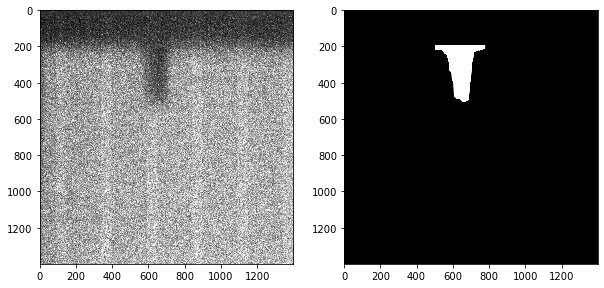

2: true_dist: 15


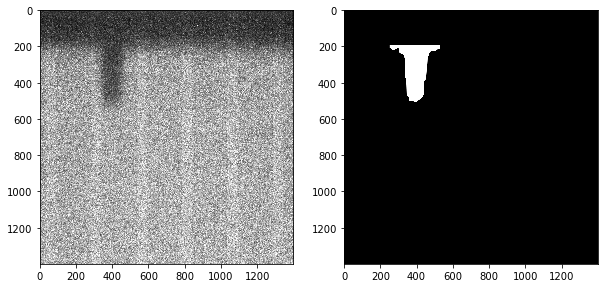

3: true_dist: 15


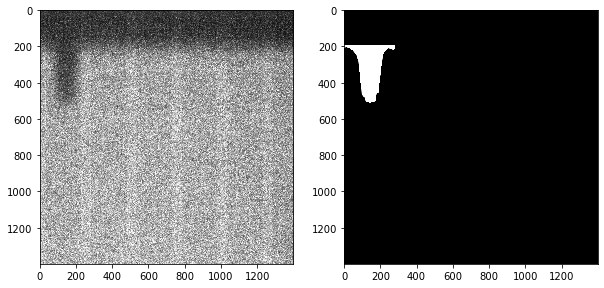

4: true_dist: 15


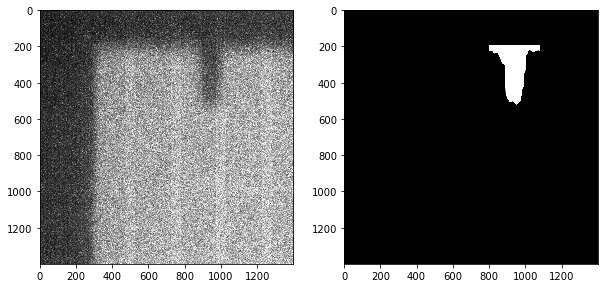

end batch 4


In [37]:
dataset = UNetDatasetFromFolders(data_folder, fname_key='File', file_extension='.tiff',
                                 included=selected_distances,
                                 transform=Compose([RandomCrop(), Swap(p=1.0), FlipUD(p=1.0), 
                                                    ChannelsFirst(), ToTensor()]))

data_loader = DataLoader(dataset, batch_size=4, num_workers=1)

plot_transformed_data(data_loader, len(dataset))

[TOP](#top)

---

<a name="fliplr"></a>

## `FlipLR`

batch 1
1: true_dist: 15


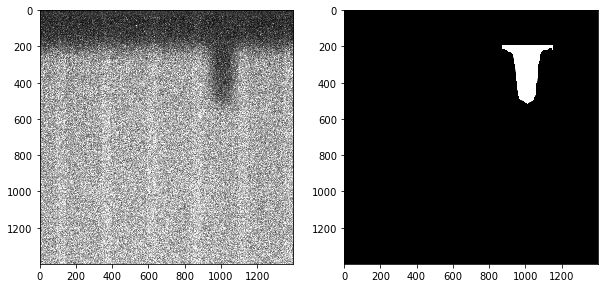

2: true_dist: 15


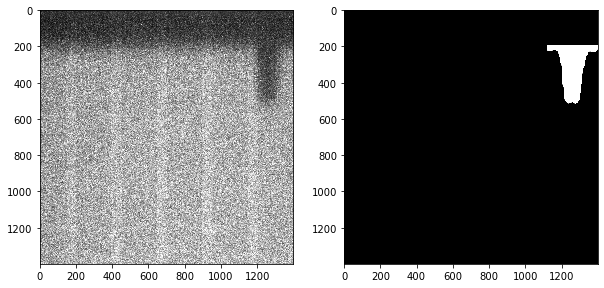

3: true_dist: 15


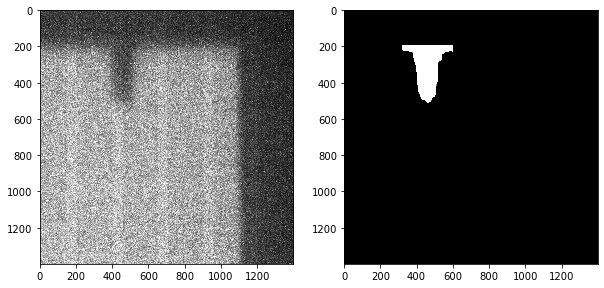

4: true_dist: 15


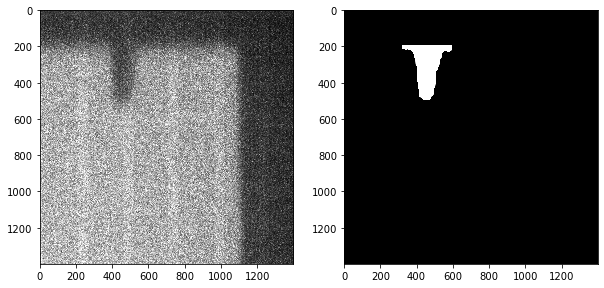

end batch 1
batch 2
1: true_dist: 15


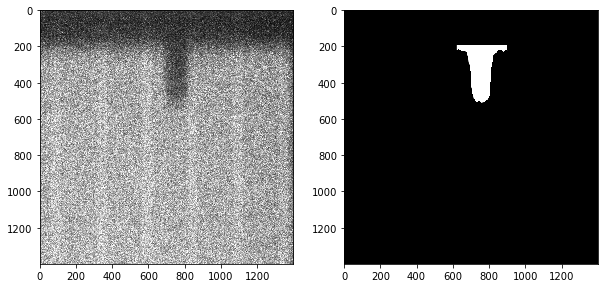

2: true_dist: 15


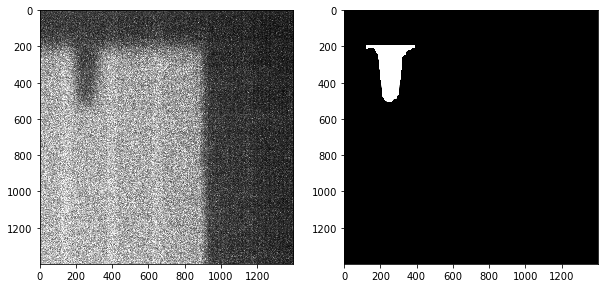

3: true_dist: 15


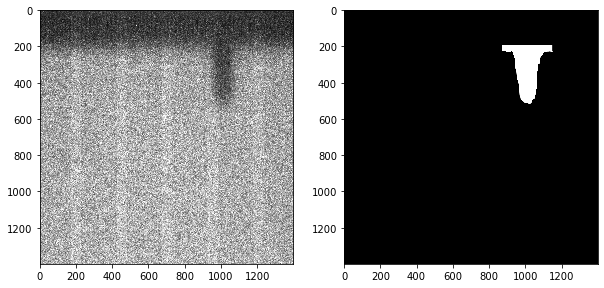

4: true_dist: 15


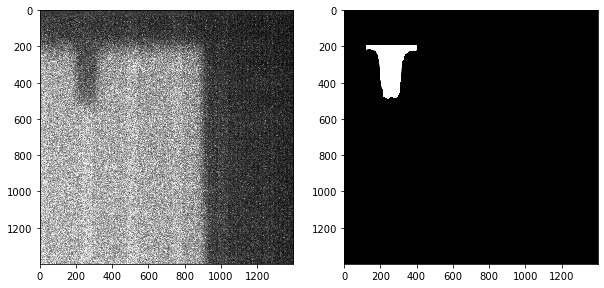

end batch 2
batch 3
1: true_dist: 15


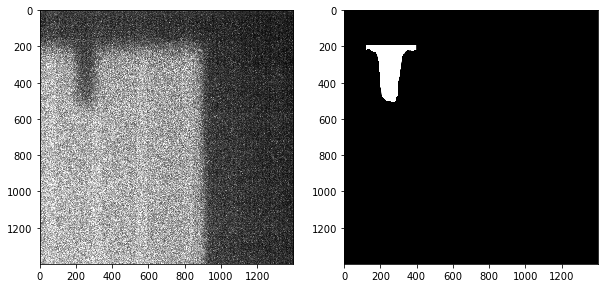

2: true_dist: 15


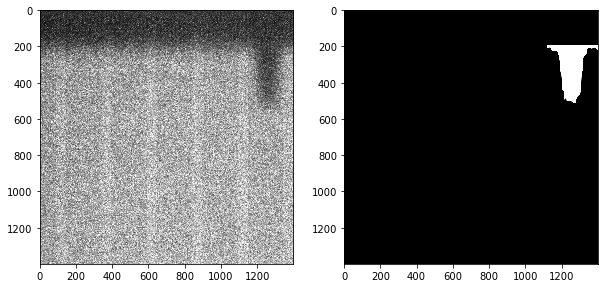

3: true_dist: 15


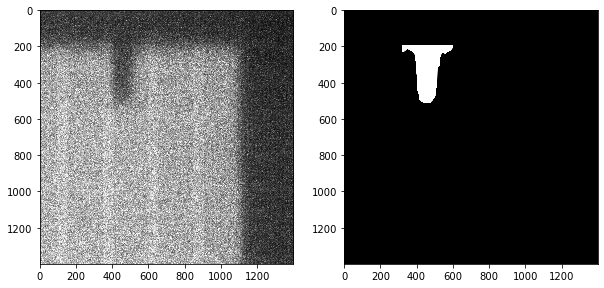

4: true_dist: 15


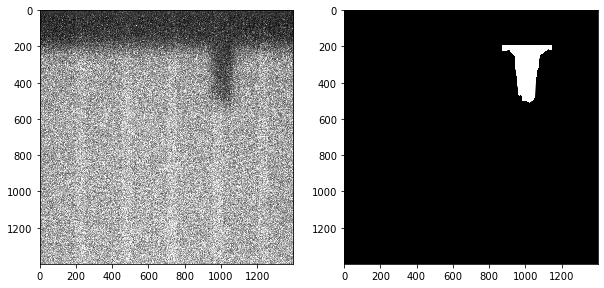

end batch 3
batch 4
1: true_dist: 15


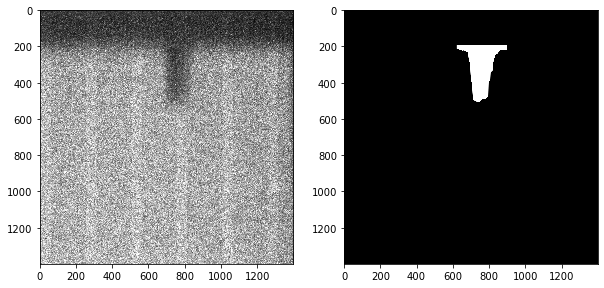

2: true_dist: 15


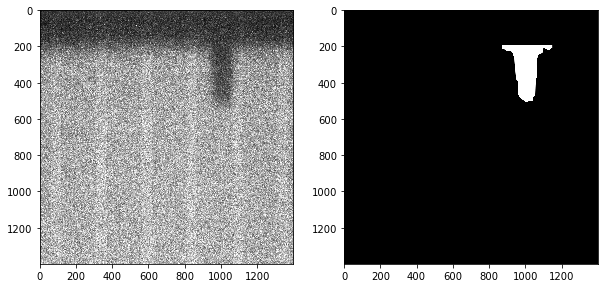

3: true_dist: 15


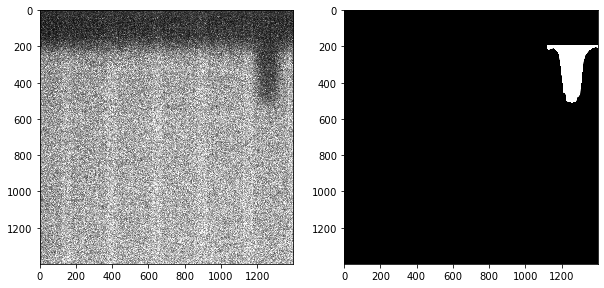

4: true_dist: 15


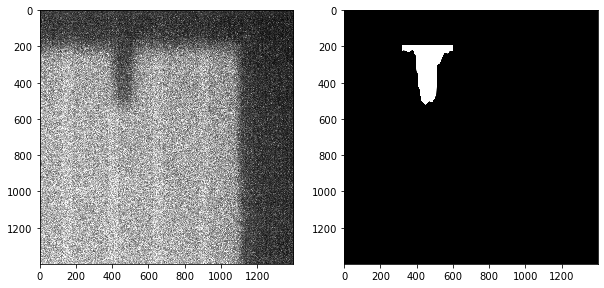

end batch 4


In [38]:
dataset = UNetDatasetFromFolders(data_folder, fname_key='File', file_extension='.tiff',
                                 included=selected_distances,
                                 transform=Compose([RandomCrop(), Swap(p=1.0), FlipUD(p=1.0), 
                                                    FlipLR(p=1.0),
                                                    ChannelsFirst(), ToTensor()]))

data_loader = DataLoader(dataset, batch_size=4, num_workers=1)

plot_transformed_data(data_loader, len(dataset))

[TOP](#top)

----

<a name="rescale"></a>

## `Rescale`

batch 1
1: true_dist: 15


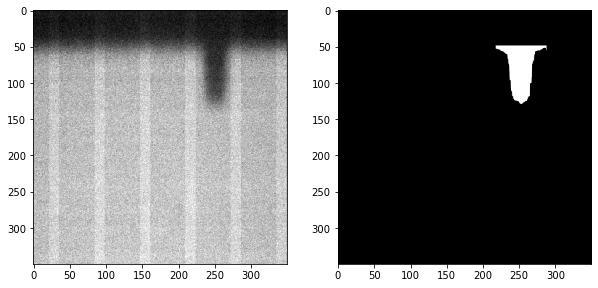

2: true_dist: 15


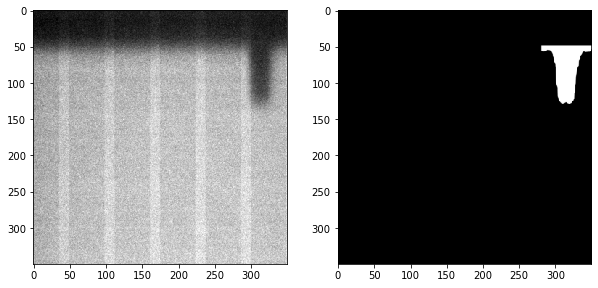

3: true_dist: 15


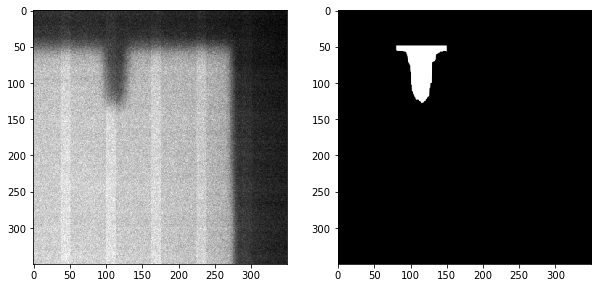

4: true_dist: 15


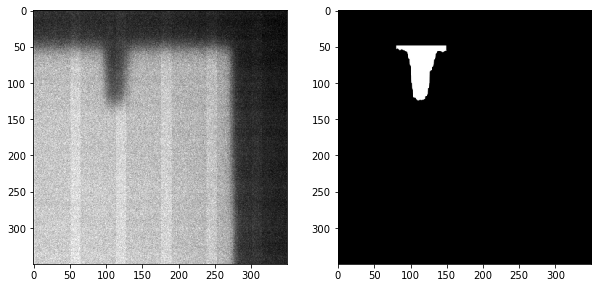

end batch 1
batch 2
1: true_dist: 15


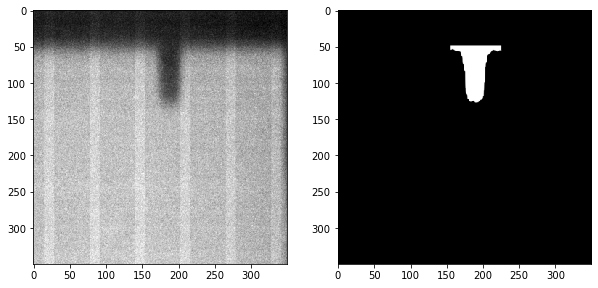

2: true_dist: 15


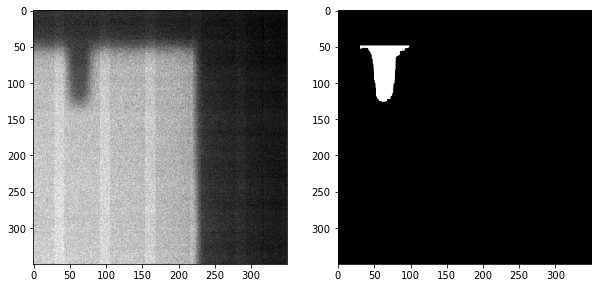

3: true_dist: 15


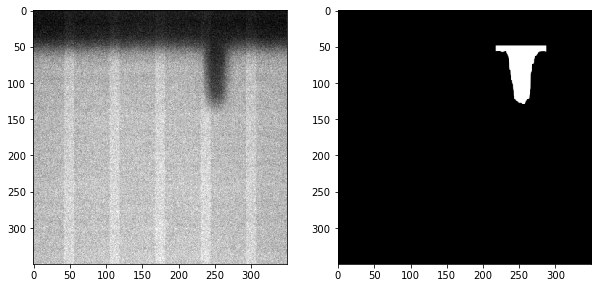

4: true_dist: 15


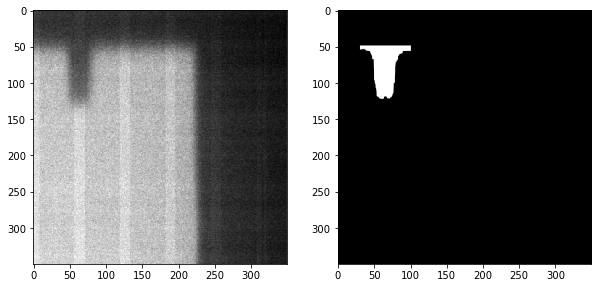

end batch 2
batch 3
1: true_dist: 15


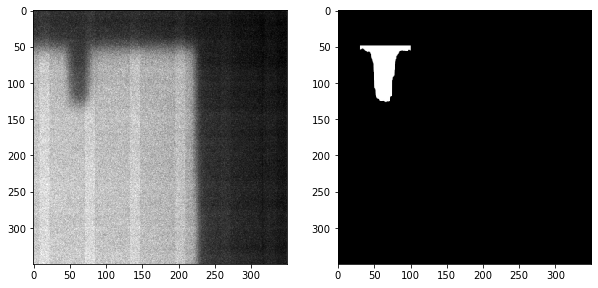

2: true_dist: 15


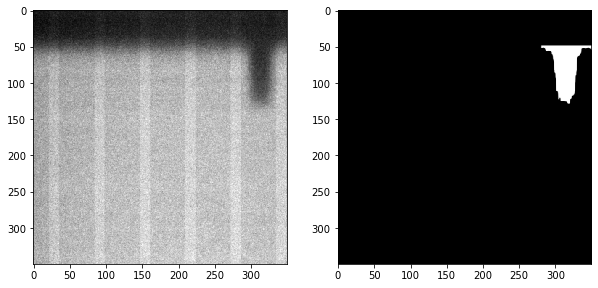

3: true_dist: 15


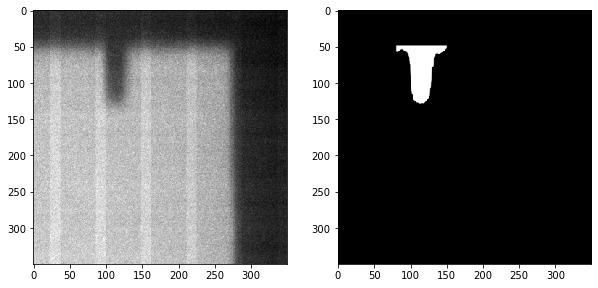

4: true_dist: 15


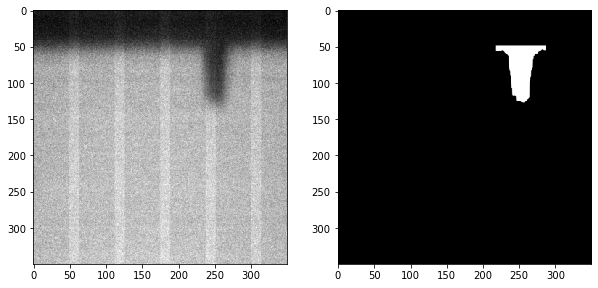

end batch 3
batch 4
1: true_dist: 15


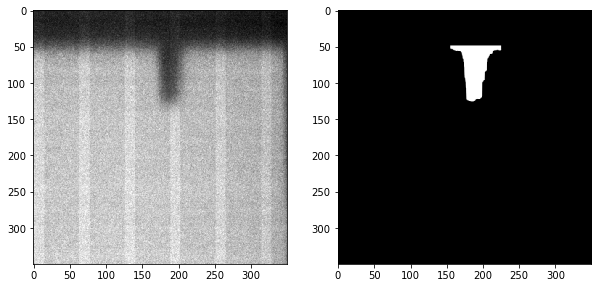

2: true_dist: 15


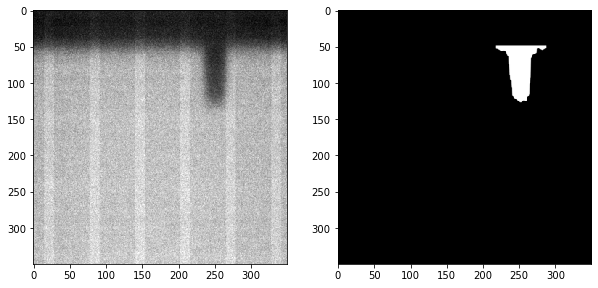

3: true_dist: 15


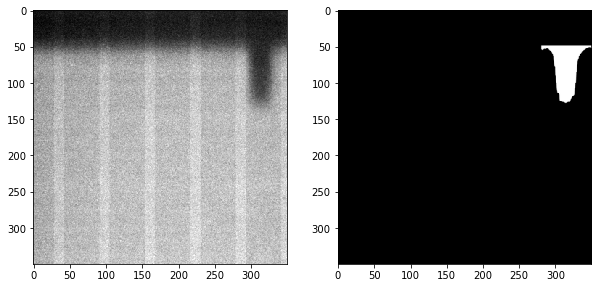

4: true_dist: 15


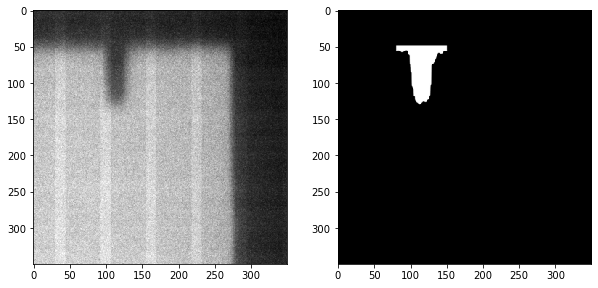

end batch 4


In [40]:
dataset = UNetDatasetFromFolders(data_folder, fname_key='File', file_extension='.tiff',
                                 included=selected_distances,
                                 transform=Compose([RandomCrop(), Swap(p=1.0), FlipUD(p=1.0), 
                                                    FlipLR(p=1.0), Rescale(0.25), 
                                                    ChannelsFirst(), ToTensor()]))

data_loader = DataLoader(dataset, batch_size=4, num_workers=1)

plot_transformed_data(data_loader, len(dataset))

[TOP](#top)

---

<a name="noise"></a>

## `GaussianNoise`

batch 1
1: true_dist: 15


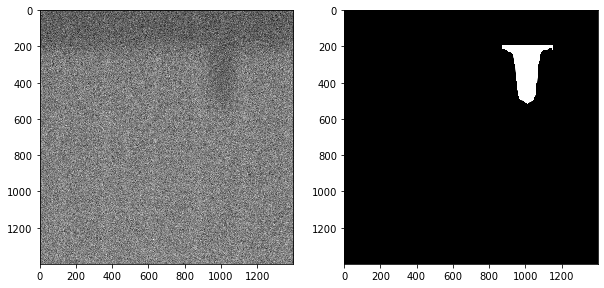

2: true_dist: 15


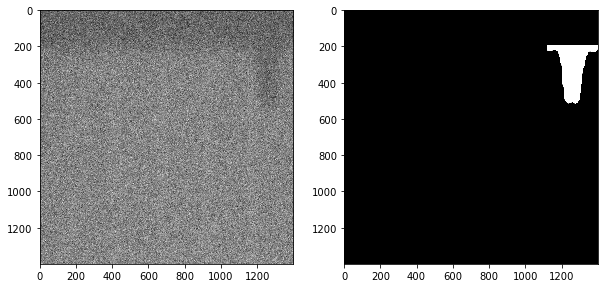

3: true_dist: 15


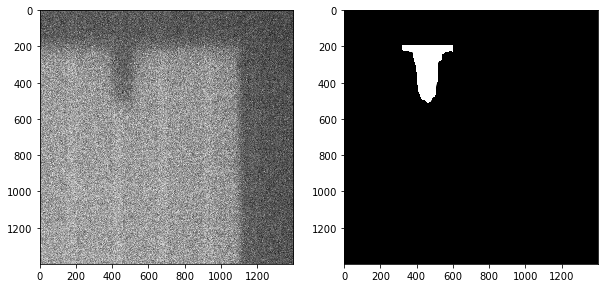

4: true_dist: 15


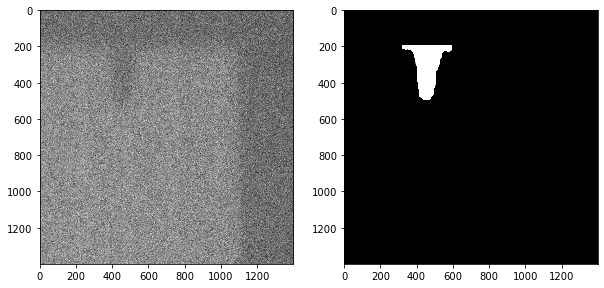

end batch 1
batch 2
1: true_dist: 15


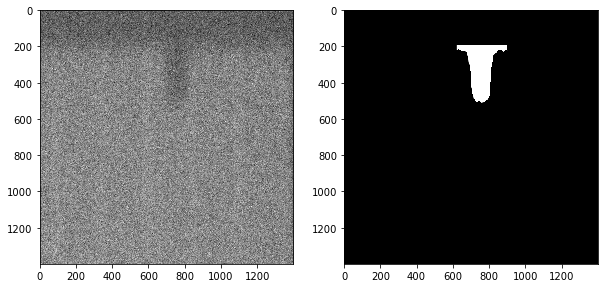

2: true_dist: 15


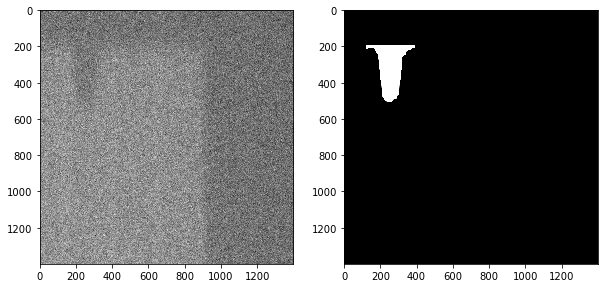

3: true_dist: 15


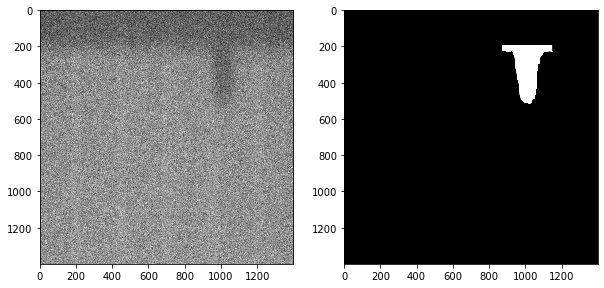

4: true_dist: 15


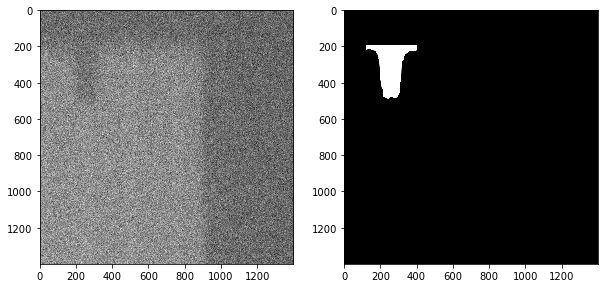

end batch 2
batch 3
1: true_dist: 15


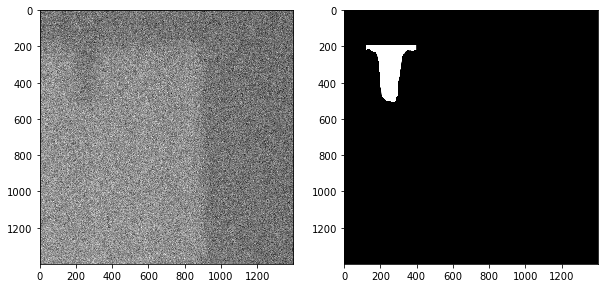

2: true_dist: 15


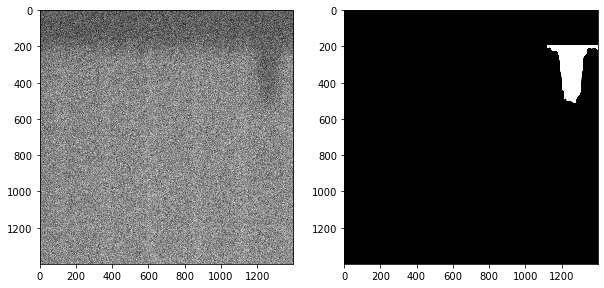

3: true_dist: 15


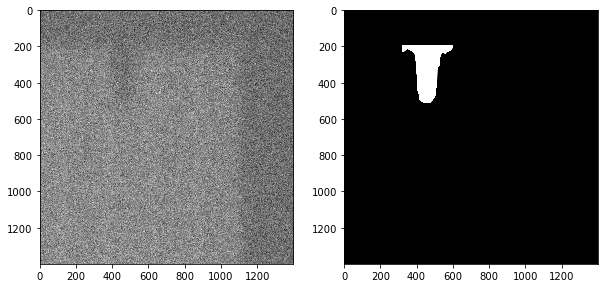

4: true_dist: 15


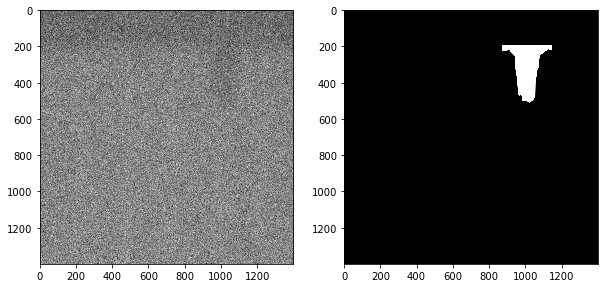

end batch 3
batch 4
1: true_dist: 15


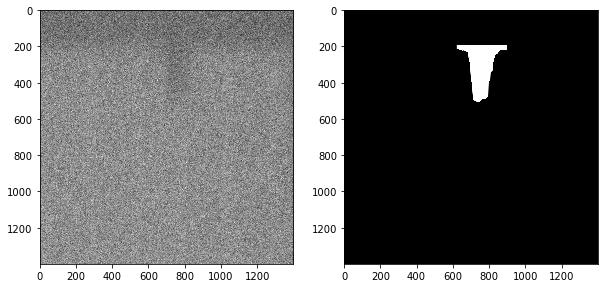

2: true_dist: 15


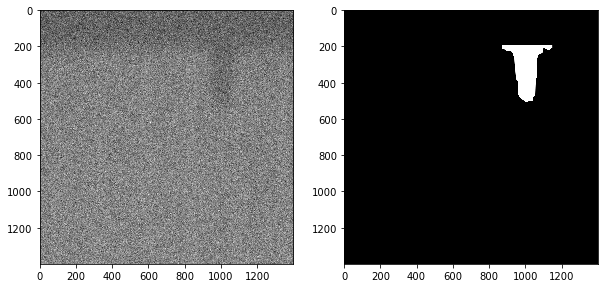

3: true_dist: 15


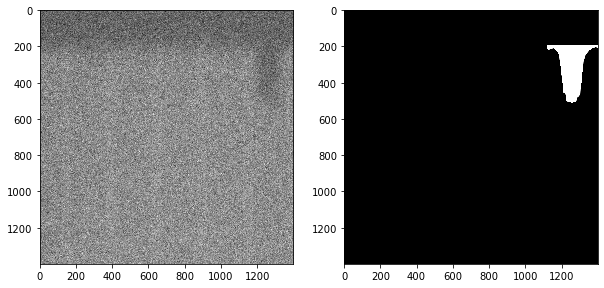

4: true_dist: 15


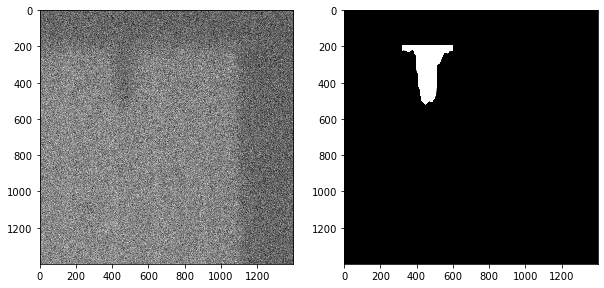

end batch 4


In [22]:
dataset = UNetDatasetFromFolders(data_folder, fname_key='File', file_extension='.tiff',
                                 included=selected_distances,
                                 transform=Compose([RandomCrop(), Swap(p=1.0), FlipUD(p=1.0), 
                                                    FlipLR(1.0), GaussianNoise(mean=1, p=1.0),
                                                    ChannelsFirst(), ToTensor()]))

data_loader = DataLoader(dataset, batch_size=4, num_workers=1)

plot_transformed_data(data_loader, len(dataset))

[TOP](#top)

---

#### Testing single `numpy` operations on images: `swap`, `fliplr`, `flipud`

In [ ]:
test = true_images[1].numpy()[0,...]

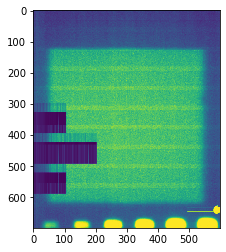

In [19]:
plt.imshow(test)

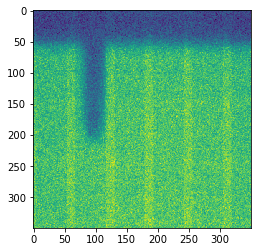

In [33]:
plt.imshow(test.swapaxes(0,1))

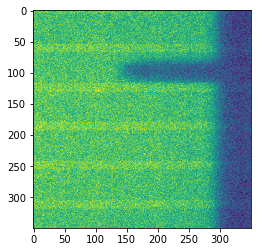

In [34]:
plt.imshow(np.fliplr(test))

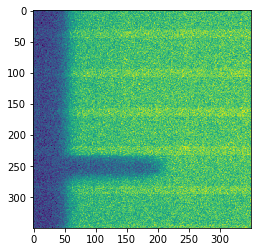

In [35]:
plt.imshow(np.flipud(test))

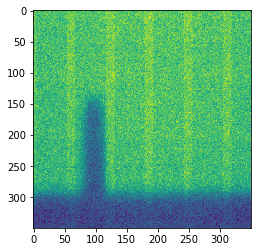

In [36]:
plt.imshow(np.fliplr(test).swapaxes(0,1))

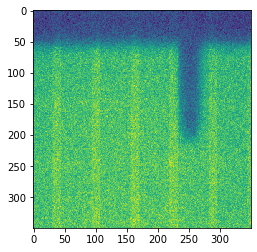

In [37]:
plt.imshow(np.flipud(test).swapaxes(0,1))

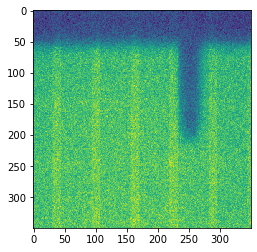

In [38]:
plt.imshow(np.fliplr(test.swapaxes(0,1)))

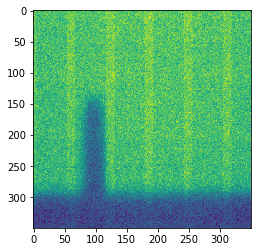

In [39]:
plt.imshow(np.flipud(test.swapaxes(0,1)))

---

In [16]:
data_loaders_mask, data_length_mask = define_dataset(data_folder, batch_size=16,
                                                    include_list=selected_distances,
                                                     alldata=False, row_slice=slice(0, 1400))

In [17]:
data_length_mask

{'train': 2261, 'val': 565, 'test': 706}

In [25]:
def predict_coef_epoch(coeff, epoch):
    filelist, epochs = get_fnames(coeff)
    model_fname = filelist[int(np.argwhere(epochs==epoch)[0])]
    print(model_fname)
    torch.cuda.empty_cache()
    model = rUNet(out_size=1)
    checkpoint = torch.load(root_path(model_fname))['model_state_dict']
    #print(checkpoint)
    model.load_state_dict(checkpoint)
    
    print('Checkpoint loaded')
    inference_phase_rUNet_plot_notebook(model, data_loaders_mask, data_length_mask,
                                       batch_size=16, stop=1, test=True)

    return 

Trained_rUNet_pytorch_6positions_dataset_100epochs_0.4coeff_mask.pkl
Checkpoint loaded


batch 1
1: true_dist: 30, pred_dist: [30.316113]


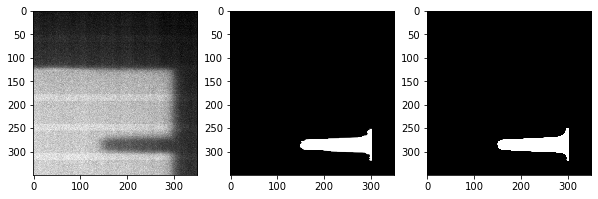

2: true_dist: 3, pred_dist: [3.0146189]


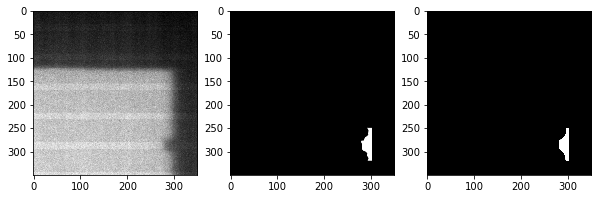

3: true_dist: 1, pred_dist: [1.4236854]


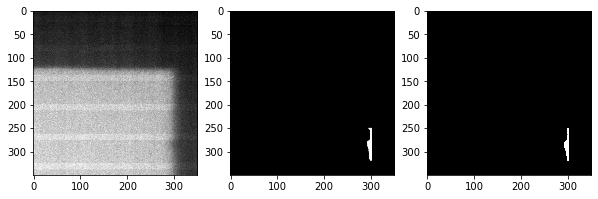

4: true_dist: 30, pred_dist: [30.297218]


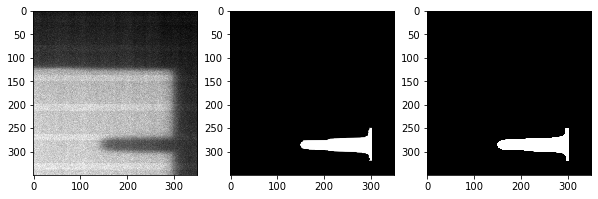

5: true_dist: 30, pred_dist: [30.36966]


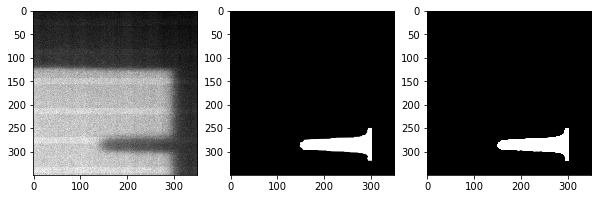

6: true_dist: 3, pred_dist: [2.9693115]


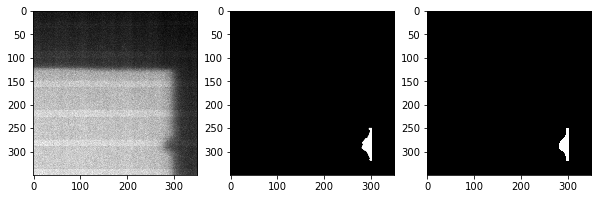

7: true_dist: 1, pred_dist: [1.3871164]


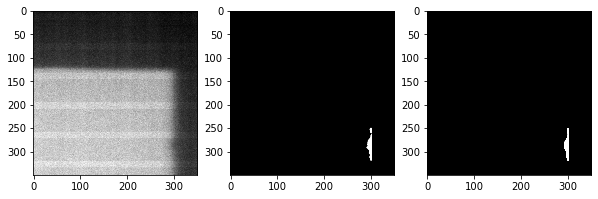

8: true_dist: 30, pred_dist: [30.330534]


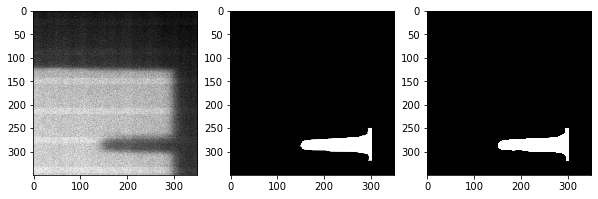

9: true_dist: 15, pred_dist: [15.047669]


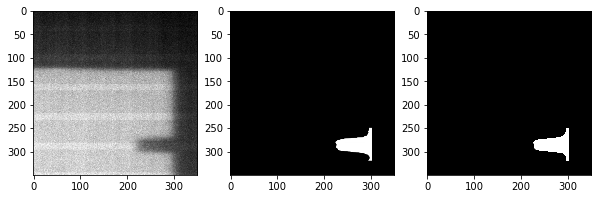

10: true_dist: 15, pred_dist: [15.088055]


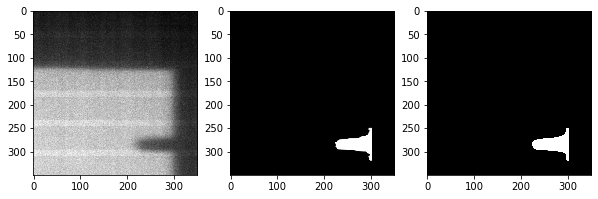

11: true_dist: 1, pred_dist: [1.3173237]


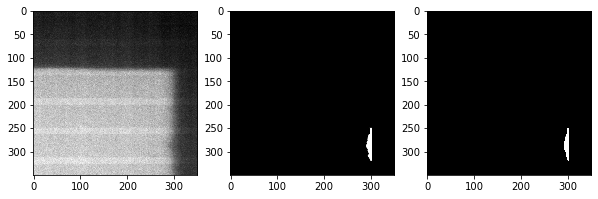

12: true_dist: 3, pred_dist: [2.8264718]


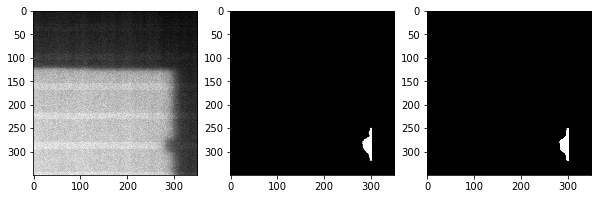

13: true_dist: 30, pred_dist: [30.185925]


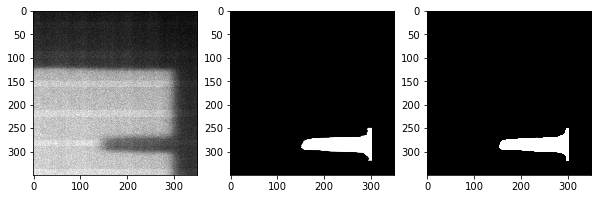

14: true_dist: 15, pred_dist: [15.044569]


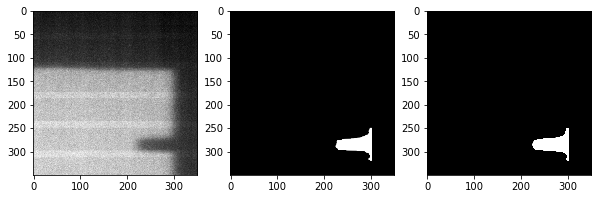

15: true_dist: 3, pred_dist: [2.9494653]


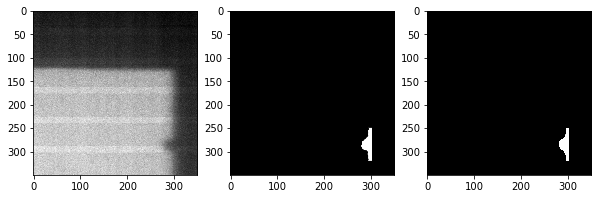

16: true_dist: 15, pred_dist: [15.1021595]


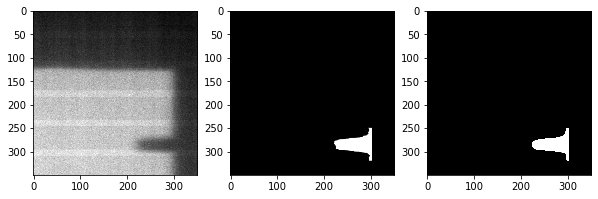

batch 2
1: true_dist: 3, pred_dist: [2.9471679]


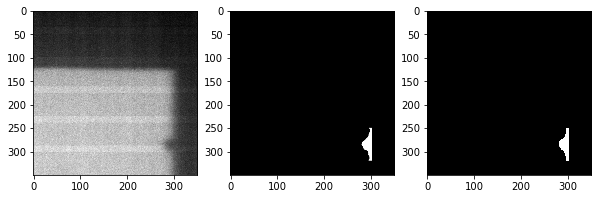

2: true_dist: 15, pred_dist: [15.120449]


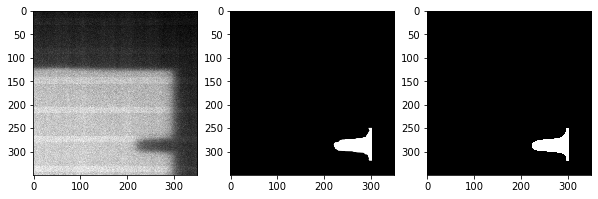

3: true_dist: 1, pred_dist: [1.3193839]


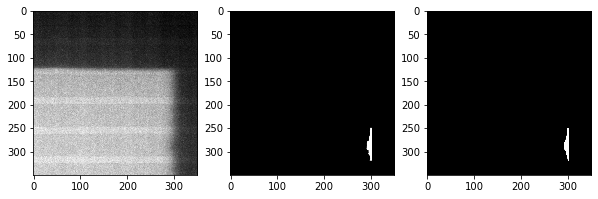

4: true_dist: 3, pred_dist: [2.9700735]


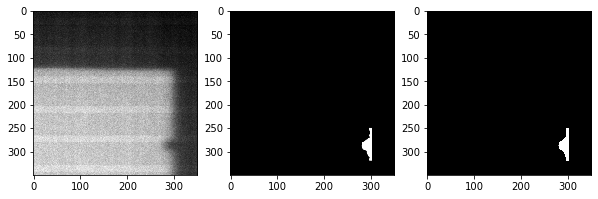

5: true_dist: 30, pred_dist: [30.193455]


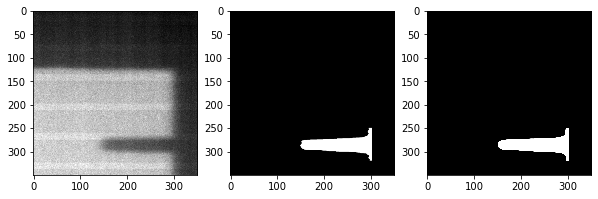

6: true_dist: 30, pred_dist: [30.075838]


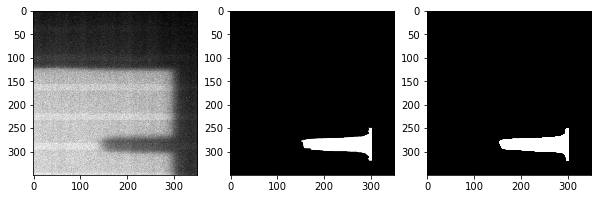

7: true_dist: 30, pred_dist: [30.363934]


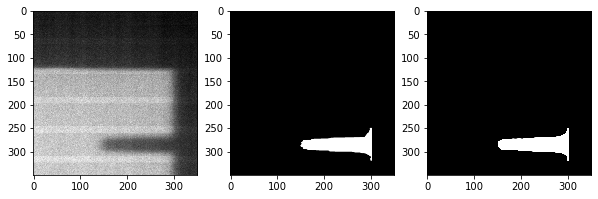

8: true_dist: 1, pred_dist: [1.4133219]


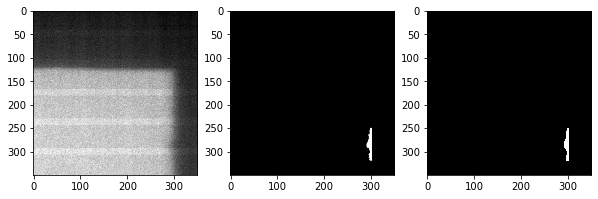

9: true_dist: 30, pred_dist: [30.195324]


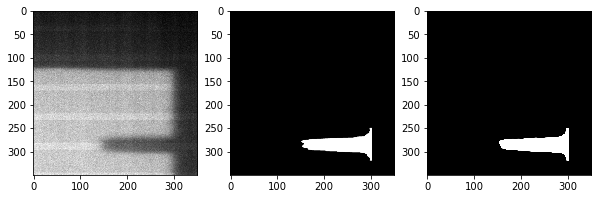

10: true_dist: 30, pred_dist: [30.362307]


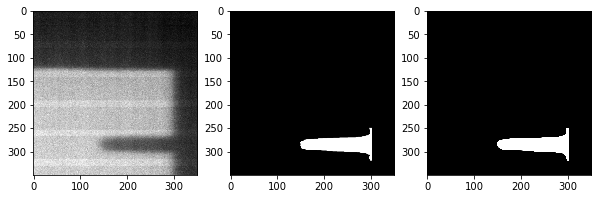

11: true_dist: 3, pred_dist: [2.88915]


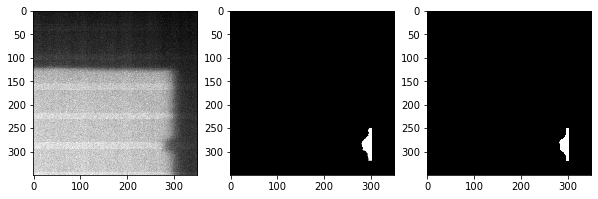

12: true_dist: 30, pred_dist: [30.364855]


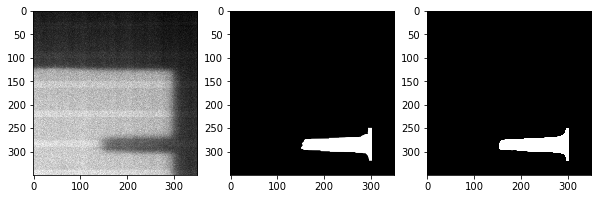

13: true_dist: 30, pred_dist: [30.200258]


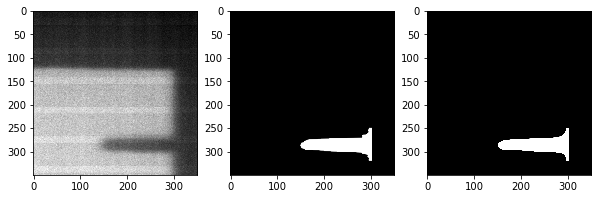

14: true_dist: 30, pred_dist: [30.189867]


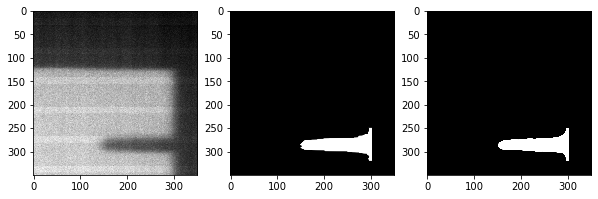

15: true_dist: 1, pred_dist: [1.4541812]


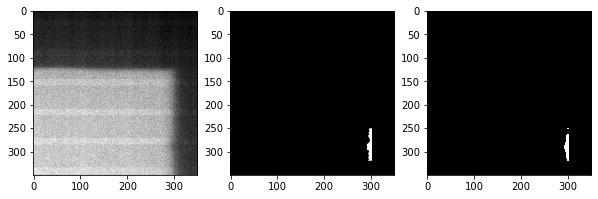

16: true_dist: 30, pred_dist: [30.145115]


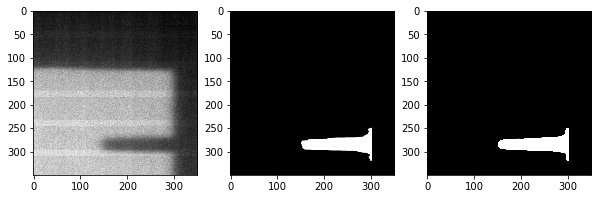

In [36]:
predict_coef_epoch(4, 100)

---